<a href="https://colab.research.google.com/github/Abhisek910/Apziva-project/blob/main/M12FPRtXuFTBFDsv/Voice_Cloning_and_Fake_Audio_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## VCFAD - Voice Cloning and Fake Audio Detection



**Background**:


We are a technology company working in the Cyber Security industry. We focus on building systems that help individuals and organizations to have safe and secure digital presence by providing cutting edge technologies to our customers. We create products and services that ensure our customers security using data driven technologies to understand whether audio and video media is authentic or fake.


Our goal in this project is to build algorithms that can synthesize spoken audio by converting a speaker’s voice to another speaker’s voice with the end goal to detect if any spoken audio is pristine or fake.


**Data Description:**


There are two datasets you can utilize in this project. Both datasets are publicly available sources.


**TIMIT Dataset:**


The TIMIT corpus of read speech is designed to provide speech data for acoustic-phonetic studies and for the development and evaluation of automatic speech recognition systems. TIMIT contains a total of 6300 sentences, 10 sentences spoken by each of 630 speakers from 8 major dialect regions of the United States.


Dataset Link: https://github.com/philipperemy/timit


**CommonVoice Dataset:**


Common Voice is part of Mozilla's initiative to help teach machines how real people speak. Common Voice is a corpus of speech data read by users on the Common Voice website (https://commonvoice.mozilla.org/), and based upon text from a number of public domain sources like user submitted blog posts, old books, movies, and other public speech corpora. Its primary purpose is to enable the training and testing of automatic speech recognition (ASR) systems.


Dataset Link: https://commonvoice.mozilla.org/en/datasets



**Goal(s):**


Build a machine learning system to detect if a spoken audio is synthetically generated or not. In order to achieve this, first, build a voice cloning system given a speaker’s spoken audio that clones the source speaker’s voice to the target speaker’s voice. Next, build a machine learning system which detects if any spoken audio is a natural speech or synthetically generated by machine.


For the voice cloning system (VC), you can utilize the TIMIT dataset as it consists of aligned text-audio data with various speakers. For the fake audio detection system (FAD) you can utilize the CommonVoice dataset as it consists of thousands of naturally spoken audio which could be used as golden spoken audio by humans as positive examples and creating negative examples using the voice cloning system as automatic data/label generator. Since the CommonVoice English dataset is large, you can use a subset of it by sampling the dataset.


**Success Metrics:**


Use Word Error Rate (WER) for automatic evaluation of the voice cloning (VC) system for the speech generation part and also report speaker classification accuracy to assess the performance of the generated audio’s target speaker. For the fake audio detection (FAD) system evaluate the performance of the models using F-score via positive labels coming from the groundtruth dataset and negative labels generated by the VC.

# Real-Time Voice Cloning

This is a colab notebook using the open source project [CorentinJ/Real-Time-Voice-Cloning](https://github.com/CorentinJ/Real-Time-Voice-Cloning)
to clone a voice.



In [ ]:
import os
from os.path import exists, join, basename, splitext

git_repo_url = 'https://github.com/CorentinJ/Real-Time-Voice-Cloning.git'
project_name = splitext(basename(git_repo_url))[0]
if not exists(project_name):
  # clone and install
  !git clone -q --recursive {git_repo_url}
  # install dependencies
  !cd {project_name} && pip install -q -r requirements.txt
  !pip install -q --upgrade gdown
  !apt-get install -qq libportaudio2
  !pip install -q https://github.com/tugstugi/dl-colab-notebooks/archive/colab_utils.zip

  # download pretrained model
  #!cd {project_name} && wget https://github.com/blue-fish/Real-Time-Voice-Cloning/releases/download/v1.0/pretrained.zip && unzip -o pretrained.zip
  !cd {project_name} && mkdir -p saved_models/default/
  !cd {project_name}/saved_models/default/ && gdown https://drive.google.com/uc?id=1q8mEGwCkFy23KZsinbuvdKAQLqNKbYf1
  !cd {project_name}/saved_models/default/ && gdown https://drive.google.com/uc?id=1EqFMIbvxffxtjiVrtykroF6_mUh-5Z3s
  !cd {project_name}/saved_models/default/ && gdown https://drive.google.com/uc?id=1cf2NO6FtI0jDuy8AV3Xgn6leO6dHjIgu

import sys
sys.path.append(project_name)

from IPython.display import display, Audio, clear_output
from IPython.utils import io
import ipywidgets as widgets
import numpy as np
from dl_colab_notebooks.audio import record_audio, upload_audio

from synthesizer.inference import Synthesizer
from encoder import inference as encoder
from vocoder import inference as vocoder
from pathlib import Path

In [ ]:

encoder.load_model(project_name / Path("/content/drive/MyDrive/Apziva /saved_models/encoder.pt"))
synthesizer = Synthesizer(project_name / Path("/content/drive/MyDrive/Apziva /saved_models/synthesizer.pt"))
vocoder.load_model(project_name / Path("/content/drive/MyDrive/Apziva /saved_models/vocoder.pt"))

Loaded encoder "encoder.pt" trained to step 1564501
Synthesizer using device: cuda
Building Wave-RNN
Trainable Parameters: 4.481M
Loading model weights at /content/drive/MyDrive/Apziva /saved_models/vocoder.pt


In [ ]:
!pip install wavio
!pip install noisereduce
!pip install speechrecognition
!pip install spacy
!python -m spacy download en_core_web_sm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.8 MB 8.0 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [ ]:
import wavio
import spacy
import pandas as pd
import numpy as np
import noisereduce as nr
import speech_recognition as sr
from scipy.io import wavfile
from IPython.display import Audio
from moviepy.editor import concatenate_audioclips, AudioFileClip

import warnings
warnings.filterwarnings("ignore")


import torch
torch.manual_seed(3407)

#### Downloading TIMIT Dataset:


The TIMIT corpus of read speech is designed to provide speech data for acoustic-phonetic studies and for the development and evaluation of automatic speech recognition systems. TIMIT contains a total of 6300 sentences, 10 sentences spoken by each of 630 speakers from 8 major dialect regions of the United States.

Dataset Link:https://github.com/philipperemy/timit

In [ ]:
!unzip "/content/drive/MyDrive/Apziva /archive (4).zip"

Streaming output truncated to the last 5000 lines.
  inflating: data/TRAIN/DR6/MTXS0/SA1.WAV  
  inflating: data/TRAIN/DR6/MTXS0/SA1.WAV.wav  
  inflating: data/TRAIN/DR6/MTXS0/SA1.WRD  
  inflating: data/TRAIN/DR6/MTXS0/SA2.PHN  
  inflating: data/TRAIN/DR6/MTXS0/SA2.TXT  
  inflating: data/TRAIN/DR6/MTXS0/SA2.WAV  
  inflating: data/TRAIN/DR6/MTXS0/SA2.WAV.wav  
  inflating: data/TRAIN/DR6/MTXS0/SA2.WRD  
  inflating: data/TRAIN/DR6/MTXS0/SI1060.PHN  
  inflating: data/TRAIN/DR6/MTXS0/SI1060.TXT  
  inflating: data/TRAIN/DR6/MTXS0/SI1060.WAV  
  inflating: data/TRAIN/DR6/MTXS0/SI1060.WAV.wav  
  inflating: data/TRAIN/DR6/MTXS0/SI1060.WRD  
  inflating: data/TRAIN/DR6/MTXS0/SI1690.PHN  
  inflating: data/TRAIN/DR6/MTXS0/SI1690.TXT  
  inflating: data/TRAIN/DR6/MTXS0/SI1690.WAV  
  inflating: data/TRAIN/DR6/MTXS0/SI1690.WAV.wav  
  inflating: data/TRAIN/DR6/MTXS0/SI1690.WRD  
  inflating: data/TRAIN/DR6/MTXS0/SI2320.PHN  
  inflating: data/TRAIN/DR6/MTXS0/SI2320.TXT  
  inflating: data

# 1) Audio Cloning Sample Experiment:

In [ ]:
train = pd.read_csv("/content/train_data.csv")
train.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


In [ ]:
def synthesize(audio, text, audio_name):
  """
  Used to clone the audio
  """
  embedding = encoder.embed_utterance(encoder.preprocess_wav(audio, 22050))
  print("Synthesizing new audio...")
  specs = synthesizer.synthesize_spectrograms([text], [embedding])
  generated_wav = vocoder.infer_waveform(specs[0])
  generated_wav = np.pad(generated_wav, (1, synthesizer.sample_rate), mode="constant")
  clear_output()
  wavio.write(audio_name, generated_wav, sampwidth=2, rate=synthesizer.sample_rate)

In [ ]:
nlp = spacy.load('en_core_web_sm')
def text_comparison(audio, text, nlp = nlp):
  """
Used to convert the cloned audio to text and compare that result with the original text with "speech_to_text" function help
  """
  new_text = speech_to_text(audio)
  original_text = nlp(text)
  return original_text.similarity(nlp(new_text))

In [ ]:
# initialize the recognizer
r = sr.Recognizer()
def speech_to_text(audio):
  """
  return the text from cloned audio
  """
  with sr.AudioFile(audio) as source:
      # listen for the data (load audio to memory)
      audio_data = r.record(source)
      # recognize (convert from speech to text)
      text = r.recognize_google(audio_data)
      return text

In [ ]:
short_original_text = 'She had your dark suit in greasy wash water all year'
long_original_text = "She had your dark suit in greasy wash water all year Don't ask me to carry an oily rag like that"

## 1.1 Short Audio:
  * Exp-1: Short Audio with a short text.
  * Exp-1: Short Audio with a long text.


**These are the original audio files**

In [ ]:
audio_1 = '/content/data/TRAIN/DR1/FCJF0/SA1.WAV.wav'
Audio(audio_1, autoplay=True)

In [ ]:
audio_2 = '/content/data/TRAIN/DR2/FAEM0/SA2.WAV.wav'
Audio(audio_2, autoplay=True)

In [ ]:
audio_3 = '/content/data/TRAIN/DR7/MKDB0/SX242.WAV.wav'
Audio(audio_3, autoplay=True)

### Exp-1

In [ ]:
synthesize(audio_1, short_original_text, 'exp-1-1.wav')
synthesize(audio_2, short_original_text, 'exp-1-2.wav')
synthesize(audio_3, short_original_text, 'exp-1-3.wav')

**These are the cloned audio file samples for experiment 1**

In [ ]:
Audio("exp-1-1.wav", autoplay=True)

In [ ]:
Audio("exp-1-2.wav", autoplay=True)

In [ ]:
Audio("exp-1-3.wav", autoplay=True)

**White noise and the disappearing of some letters are common things in the experiment 1 result, especially audio 1.**

In [ ]:
exp_1_text_1_score =text_comparison("exp-1-1.wav", short_original_text)
exp_1_text_2_score =text_comparison("exp-1-2.wav", short_original_text)
exp_1_text_3_score =text_comparison("exp-1-3.wav", short_original_text)

In [ ]:
print(f"First audio score is: {exp_1_text_1_score}")
print(f"Second audio score is: {exp_1_text_2_score}")
print(f"Third audio score is: {exp_1_text_3_score}")

First audio score is: 0.472968735409387
Second audio score is: 0.7006915428115149
Third audio score is: 0.8547345526474789


### Exp-2

In [ ]:
synthesize(audio_1, long_original_text, "exp-2-1.wav")
synthesize(audio_2, long_original_text, "exp-2-2.wav")
synthesize(audio_3, long_original_text, "exp-2-3.wav")

In [ ]:
Audio("exp-2-1.wav", autoplay=True)

In [ ]:

Audio("exp-2-2.wav", autoplay=True)

In [ ]:
Audio("exp-2-3.wav", autoplay=True)

In [ ]:
exp_2_text_1_score = text_comparison('exp-2-1.wav', long_original_text)
exp_2_text_2_score = text_comparison('exp-2-2.wav', long_original_text)
exp_2_text_3_score = text_comparison('exp-2-3.wav', long_original_text)

In [ ]:
print(f"First audio score is:  {exp_2_text_1_score}")
print(f"Second audio score is: {exp_2_text_2_score}")
print(f"Third audio score is:  {exp_2_text_3_score}")

First audio score is:  0.2523994995747764
Second audio score is: 0.8818847937760863
Third audio score is:  0.8551836224175114


## 1.2 Long Adio:
 * Exp-3: Long Audio with a short text.
 * Exp-4: Long Audio with a long text.

In [ ]:
train.path_from_data_dir = [f"data/{i}" for i in train.path_from_data_dir]

In [ ]:
# create a dic with unique speaker_id as a key for the dic
speaker_id_dic = {}
for i in train.speaker_id.unique():
  speaker_id_dic[i] = []

In [ ]:

## All the audio file for each speaker as a value of each key 
for i in range(train.shape[0]):
  for key,value in speaker_id_dic.items():
    if train.speaker_id[i] == key:
      if train.path_from_data_dir[i].endswith('.wav'):
        value.append(train.path_from_data_dir[i])

In [ ]:
def long_audio(files, file_name):
  """
  take multiple audio file and concatenate them into one file
  """
  clips = [AudioFileClip(c) for c in files]
  final_clip =concatenate_audioclips(clips)
  final_clip.write_audiofile(file_name)

In [ ]:
## Apply long_audio_function on a sample_speaker to convert the short audio file to one
long_audio(speaker_id_dic["MWGR0"], "long-audio-1.wav")
long_audio(speaker_id_dic["MWDK0"], "long-audio-2.wav")
long_audio(speaker_id_dic["MTWH1"], "long-audio-3.wav")

[MoviePy] Writing audio in long-audio-1.wav


100%|██████████| 631/631 [00:00<00:00, 2205.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in long-audio-2.wav


100%|██████████| 661/661 [00:00<00:00, 1993.73it/s]

[MoviePy] Done.


[MoviePy] Writing audio in long-audio-3.wav


100%|██████████| 584/584 [00:00<00:00, 2182.21it/s]

[MoviePy] Done.


In [ ]:
audio_4 = "long-audio-1.wav"
Audio(audio_4, autoplay=True)

In [ ]:
audio_5 = "long-audio-2.wav"
Audio(audio_5, autoplay=True)

In [ ]:
audio_6 = "long-audio-3.wav"
Audio(audio_6, autoplay=True)

### Exp-3

In [ ]:
synthesize(audio_4, short_original_text, "exp-3-1.wav")
synthesize(audio_5, short_original_text, "exp-3-2.wav")
synthesize(audio_6, short_original_text, "exp-3-3.wav")

In [ ]:
Audio("exp-3-1.wav", autoplay=True)


In [ ]:
Audio("exp-3-2.wav", autoplay=True)

In [ ]:
Audio("exp-3-3.wav", autoplay=True)

In [ ]:
exp_3_text_1_score = text_comparison("exp-3-1.wav", short_original_text)
exp_3_text_2_score = text_comparison("exp-3-2.wav", short_original_text)
exp_3_text_3_score = text_comparison("exp-3-3.wav", short_original_text)

In [ ]:
print(f"First audio score is:  {exp_3_text_1_score}")
print(f"Second audio score is: {exp_3_text_2_score}")
print(f"Third audio score is:  {exp_3_text_3_score}")

First audio score is:  0.7758151533405646
Second audio score is: 0.8547345526474789
Third audio score is:  0.7266688440502315


### Exp-4

In [ ]:
synthesize(audio_4 , long_original_text , "exp-4-1.wav")
synthesize(audio_5 , long_original_text , "exp-4-2.wav")
synthesize(audio_6 , long_original_text , "exp-4-3.wav")

In [ ]:
Audio("exp-4-1.wav", autoplay=True)

In [ ]:
Audio("exp-4-2.wav", autoplay=True)

In [ ]:
Audio("exp-4-3.wav", autoplay=True)

In [ ]:
exp_4_text_1_score = text_comparison("exp-4-1.wav", long_original_text)
exp_4_text_2_score = text_comparison("exp-4-2.wav", long_original_text)
exp_4_text_3_score = text_comparison("exp-4-3.wav", long_original_text)

In [ ]:
print(f"First audio score is:  {exp_4_text_1_score}")
print(f"Second audio score is: {exp_4_text_2_score}")
print(f"Third audio score is:  {exp_4_text_3_score}")

First audio score is:  0.7561658139027845
Second audio score is: 0.6814221530525724
Third audio score is:  0.7508678692706736


### 2) Voice Cloning:


As the Expirement:-3 results was better than other expirment ,we will apply the voice cloning by the same method for all of the long audios.

In [ ]:
train = pd.read_csv("/content/train_data.csv")
test = pd.read_csv("/content/test_data.csv")

In [ ]:
train.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


In [ ]:
test.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TEST,DR4,MGMM0,SX139.WAV,TEST/DR4/MGMM0/SX139.WAV,TEST\\DR4\\MGMM0\\SX139.WAV,False,True,False,False,False
1,2.0,TEST,DR4,MGMM0,SX139.WAV.wav,TEST/DR4/MGMM0/SX139.WAV.wav,TEST\\DR4\\MGMM0\\SX139.WAV.wav,True,True,False,False,False
2,3.0,TEST,DR4,MGMM0,SX139.TXT,TEST/DR4/MGMM0/SX139.TXT,TEST\\DR4\\MGMM0\\SX139.TXT,False,False,False,False,True
3,4.0,TEST,DR4,MGMM0,SI499.WRD,TEST/DR4/MGMM0/SI499.WRD,TEST\\DR4\\MGMM0\\SI499.WRD,False,False,True,False,False
4,5.0,TEST,DR4,MGMM0,SX319.WRD,TEST/DR4/MGMM0/SX319.WRD,TEST\\DR4\\MGMM0\\SX319.WRD,False,False,True,False,False


In [ ]:
train.shape, test.shape

((31678, 12), (31678, 12))

In [ ]:
train = train.dropna()
test = test.dropna()
train.shape, test.shape

((8400, 12), (8400, 12))

In [ ]:
train.path_from_data_dir = [f"data/{i}" for i in train.path_from_data_dir]
test.path_from_data_dir  = [f"data/{i}" for i in test.path_from_data_dir ] 

In [ ]:
train.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,data/TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,data/TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,data/TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,data/TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,data/TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


In [ ]:
train.speaker_id.nunique()

168

In [ ]:
test.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TEST,DR4,MGMM0,SX139.WAV,data/TEST/DR4/MGMM0/SX139.WAV,TEST\\DR4\\MGMM0\\SX139.WAV,False,True,False,False,False
1,2.0,TEST,DR4,MGMM0,SX139.WAV.wav,data/TEST/DR4/MGMM0/SX139.WAV.wav,TEST\\DR4\\MGMM0\\SX139.WAV.wav,True,True,False,False,False
2,3.0,TEST,DR4,MGMM0,SX139.TXT,data/TEST/DR4/MGMM0/SX139.TXT,TEST\\DR4\\MGMM0\\SX139.TXT,False,False,False,False,True
3,4.0,TEST,DR4,MGMM0,SI499.WRD,data/TEST/DR4/MGMM0/SI499.WRD,TEST\\DR4\\MGMM0\\SI499.WRD,False,False,True,False,False
4,5.0,TEST,DR4,MGMM0,SX319.WRD,data/TEST/DR4/MGMM0/SX319.WRD,TEST\\DR4\\MGMM0\\SX319.WRD,False,False,True,False,False


In [ ]:
test.speaker_id.nunique()

168

In [ ]:
df =pd.concat([train, test], axis=0)
df.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,data/TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,data/TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,data/TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,data/TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,data/TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


In [ ]:
df= df.reset_index(drop=True)

In [ ]:
#Create speaker dic
speaker_id_dic  = {}
for i in df.speaker_id.unique():
  speaker_id_dic[i] = []

In [ ]:
for i in range(df.shape[0]):
  for key, value in speaker_id_dic.items():
    if df.speaker_id[i] ==key:
      if df.path_from_data_dir[i].endswith(".wav"):
        value.append(df.path_from_data_dir[i])

In [ ]:
#convert the short audio files to long ones for all of the audio files
for key, value in speaker_id_dic.items():
  files = speaker_id_dic[key]
  clips = [AudioFileClip(c) for c in files]
  final_clip = concatenate_audioclips(clips)
  final_clip.write_audiofile(f"/content/drive/MyDrive/Apziva /long_version_audio/{key}.wav")

[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMDM0.wav


100%|██████████| 665/665 [00:00<00:00, 1665.71it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCSS0.wav


100%|██████████| 694/694 [00:00<00:00, 1725.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCDR0.wav


100%|██████████| 729/729 [00:00<00:00, 1690.48it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLEL0.wav


100%|██████████| 769/769 [00:00<00:00, 1726.74it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FEEH0.wav


100%|██████████| 690/690 [00:00<00:00, 1684.29it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MFWK0.wav


100%|██████████| 651/651 [00:00<00:00, 1106.64it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKAM0.wav


100%|██████████| 709/709 [00:00<00:00, 1095.53it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSMS0.wav


100%|██████████| 666/666 [00:00<00:00, 1553.17it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGJC0.wav


100%|██████████| 750/750 [00:00<00:00, 1585.02it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLKM0.wav


100%|██████████| 779/779 [00:00<00:00, 1724.02it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMGC0.wav


100%|██████████| 623/623 [00:00<00:00, 1570.52it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJXL0.wav


100%|██████████| 698/698 [00:00<00:00, 1605.21it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMBS0.wav


100%|██████████| 739/739 [00:00<00:00, 1704.13it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTQC0.wav


100%|██████████| 921/921 [00:00<00:00, 1722.05it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBWP0.wav


100%|██████████| 703/703 [00:00<00:00, 1647.37it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MFRM0.wav


100%|██████████| 629/629 [00:00<00:00, 1648.63it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJRH0.wav


100%|██████████| 662/662 [00:00<00:00, 1675.01it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLSH0.wav


100%|██████████| 700/700 [00:00<00:00, 1734.47it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTAS0.wav


100%|██████████| 535/535 [00:00<00:00, 1678.17it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLJC0.wav


100%|██████████| 681/681 [00:00<00:00, 1750.71it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJSR0.wav


100%|██████████| 826/826 [00:00<00:00, 1683.45it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJAC0.wav


100%|██████████| 680/680 [00:00<00:00, 1482.77it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCAG0.wav


100%|██████████| 601/601 [00:00<00:00, 1724.94it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJWB1.wav


100%|██████████| 621/621 [00:00<00:00, 1630.48it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSAK0.wav


100%|██████████| 650/650 [00:00<00:00, 1511.42it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJPM1.wav


100%|██████████| 660/660 [00:00<00:00, 1710.43it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPEB0.wav


100%|██████████| 606/606 [00:00<00:00, 1604.35it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MARW0.wav


100%|██████████| 703/703 [00:00<00:00, 1770.64it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLHD0.wav


100%|██████████| 626/626 [00:00<00:00, 1723.89it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MESG0.wav


100%|██████████| 664/664 [00:00<00:00, 1643.76it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSSB0.wav


100%|██████████| 738/738 [00:00<00:00, 1757.56it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTRC0.wav


100%|██████████| 575/575 [00:00<00:00, 1506.94it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDMA0.wav


100%|██████████| 781/781 [00:00<00:00, 1636.19it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRFL0.wav


100%|██████████| 747/747 [00:00<00:00, 1728.33it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FALR0.wav


100%|██████████| 634/634 [00:00<00:00, 1656.00it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJDC0.wav


100%|██████████| 606/606 [00:00<00:00, 1493.88it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPRK0.wav


100%|██████████| 836/836 [00:00<00:00, 1790.50it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJJJ0.wav


100%|██████████| 735/735 [00:00<00:00, 1740.63it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FBMJ0.wav


100%|██████████| 759/759 [00:00<00:00, 1653.75it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGAG0.wav


100%|██████████| 601/601 [00:00<00:00, 1556.47it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSTF0.wav


100%|██████████| 714/714 [00:00<00:00, 1492.45it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLJH0.wav


100%|██████████| 890/890 [00:00<00:00, 1617.38it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJXP0.wav


100%|██████████| 620/620 [00:00<00:00, 1734.50it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBMA0.wav


100%|██████████| 649/649 [00:00<00:00, 1728.26it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRGM0.wav


100%|██████████| 820/820 [00:00<00:00, 1613.87it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDKN0.wav


100%|██████████| 772/772 [00:00<00:00, 1626.24it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRAB1.wav


100%|██████████| 675/675 [00:00<00:00, 1716.47it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJWS0.wav


100%|██████████| 712/712 [00:00<00:00, 1719.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJMM0.wav


100%|██████████| 610/610 [00:00<00:00, 1636.70it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRSP0.wav


100%|██████████| 698/698 [00:00<00:00, 1487.33it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FBAS0.wav


100%|██████████| 733/733 [00:00<00:00, 1666.01it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGRP0.wav


100%|██████████| 741/741 [00:00<00:00, 1656.52it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGXP0.wav


100%|██████████| 729/729 [00:00<00:00, 1629.31it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSFH0.wav


100%|██████████| 849/849 [00:00<00:00, 1604.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MAEB0.wav


100%|██████████| 641/641 [00:00<00:00, 1740.23it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FKDW0.wav


100%|██████████| 660/660 [00:00<00:00, 1700.25it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTRT0.wav


100%|██████████| 640/640 [00:00<00:00, 1463.61it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FPAF0.wav


100%|██████████| 720/720 [00:00<00:00, 1625.13it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJLS0.wav


100%|██████████| 707/707 [00:00<00:00, 1661.32it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJEE0.wav


100%|██████████| 656/656 [00:00<00:00, 1712.48it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLBC0.wav


100%|██████████| 651/651 [00:00<00:00, 1654.78it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPRT0.wav


100%|██████████| 599/599 [00:00<00:00, 1761.25it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MNET0.wav


100%|██████████| 606/606 [00:00<00:00, 1716.85it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDCD0.wav


100%|██████████| 642/642 [00:00<00:00, 1500.39it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FKLC0.wav


100%|██████████| 710/710 [00:00<00:00, 1525.47it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJLB0.wav


100%|██████████| 610/610 [00:00<00:00, 1646.48it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSRG0.wav


100%|██████████| 611/611 [00:00<00:00, 1565.87it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSMC0.wav


100%|██████████| 677/677 [00:00<00:00, 1645.83it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDNS0.wav


100%|██████████| 661/661 [00:00<00:00, 1659.76it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKXL0.wav


100%|██████████| 644/644 [00:00<00:00, 1707.97it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPRD0.wav


100%|██████████| 755/755 [00:00<00:00, 1532.75it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MAKR0.wav


100%|██████████| 500/500 [00:00<00:00, 1697.21it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MILB0.wav


100%|██████████| 621/621 [00:00<00:00, 1636.85it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FNTB0.wav


100%|██████████| 636/636 [00:00<00:00, 1706.64it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRBC0.wav


100%|██████████| 653/653 [00:00<00:00, 1647.21it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MAPV0.wav


100%|██████████| 726/726 [00:00<00:00, 1675.92it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRTC0.wav


100%|██████████| 730/730 [00:00<00:00, 1692.89it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTJM0.wav


100%|██████████| 654/654 [00:00<00:00, 1620.19it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCDC0.wav


100%|██████████| 640/640 [00:00<00:00, 1659.01it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTPP0.wav


100%|██████████| 632/632 [00:00<00:00, 1773.62it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMJF0.wav


100%|██████████| 711/711 [00:00<00:00, 1618.09it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSLS0.wav


100%|██████████| 687/687 [00:00<00:00, 1630.85it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRTJ0.wav


100%|██████████| 849/849 [00:00<00:00, 1694.75it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTLB0.wav


100%|██████████| 685/685 [00:00<00:00, 1714.22it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MHMR0.wav


100%|██████████| 702/702 [00:00<00:00, 1578.61it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MFMC0.wav


100%|██████████| 727/727 [00:00<00:00, 1632.83it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FALK0.wav


100%|██████████| 689/689 [00:00<00:00, 1555.53it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MWDK0.wav


100%|██████████| 661/661 [00:00<00:00, 1696.09it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLTM0.wav


100%|██████████| 712/712 [00:00<00:00, 1648.19it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCDD0.wav


100%|██████████| 591/591 [00:00<00:00, 1712.89it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDWM0.wav


100%|██████████| 680/680 [00:00<00:00, 1703.91it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLAC0.wav


100%|██████████| 626/626 [00:00<00:00, 1554.59it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMEB0.wav


100%|██████████| 624/624 [00:00<00:00, 1737.52it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTKP0.wav


100%|██████████| 695/695 [00:00<00:00, 1606.87it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJRH1.wav


100%|██████████| 673/673 [00:00<00:00, 1570.04it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDLC0.wav


100%|██████████| 732/732 [00:00<00:00, 1032.06it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBEF0.wav


100%|██████████| 545/545 [00:00<00:00, 1613.32it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRDS0.wav


100%|██████████| 592/592 [00:00<00:00, 1682.83it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGAF0.wav


100%|██████████| 584/584 [00:00<00:00, 1649.51it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJLG1.wav


100%|██████████| 616/616 [00:00<00:00, 1792.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJJB0.wav


100%|██████████| 676/676 [00:00<00:00, 1776.50it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSFV0.wav


100%|██████████| 760/760 [00:00<00:00, 1609.56it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJDA0.wav


100%|██████████| 580/580 [00:00<00:00, 1648.91it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FGCS0.wav


100%|██████████| 641/641 [00:00<00:00, 1671.95it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCEF0.wav


100%|██████████| 636/636 [00:00<00:00, 1679.01it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MVJH0.wav


100%|██████████| 635/635 [00:00<00:00, 1723.65it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FGRW0.wav


100%|██████████| 780/780 [00:00<00:00, 1738.67it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJB1.wav


100%|██████████| 782/782 [00:00<00:00, 1643.69it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDFB0.wav


100%|██████████| 568/568 [00:00<00:00, 1602.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJKR0.wav


100%|██████████| 689/689 [00:00<00:00, 1795.76it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCAL0.wav


100%|██████████| 658/658 [00:00<00:00, 1645.69it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMJB1.wav


100%|██████████| 706/706 [00:00<00:00, 1697.62it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTPG0.wav


100%|██████████| 618/618 [00:00<00:00, 1763.39it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDTB0.wav


100%|██████████| 572/572 [00:00<00:00, 1611.66it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRWA0.wav


100%|██████████| 649/649 [00:00<00:00, 1625.91it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMAR0.wav


100%|██████████| 821/821 [00:00<00:00, 1676.73it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDHS0.wav


100%|██████████| 608/608 [00:00<00:00, 1781.14it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLNS0.wav


100%|██████████| 605/605 [00:00<00:00, 1710.73it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FPAZ0.wav


100%|██████████| 692/692 [00:00<00:00, 1494.37it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDEF0.wav


100%|██████████| 603/603 [00:00<00:00, 1649.19it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDBB1.wav


100%|██████████| 621/621 [00:00<00:00, 1537.76it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MREH1.wav


100%|██████████| 779/779 [00:00<00:00, 1694.12it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSJS0.wav


100%|██████████| 737/737 [00:00<00:00, 1770.67it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJLG0.wav


100%|██████████| 661/661 [00:00<00:00, 1697.61it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDLH0.wav


100%|██████████| 705/705 [00:00<00:00, 1765.61it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MHJB0.wav


100%|██████████| 537/537 [00:00<00:00, 1612.43it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSKC0.wav


100%|██████████| 617/617 [00:00<00:00, 1698.88it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCKE0.wav


100%|██████████| 617/617 [00:00<00:00, 1506.60it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDJM0.wav


100%|██████████| 644/644 [00:00<00:00, 1675.94it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MWGR0.wav


100%|██████████| 631/631 [00:00<00:00, 1648.62it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCMG0.wav


100%|██████████| 730/730 [00:00<00:00, 1569.08it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MAKB0.wav


100%|██████████| 826/826 [00:00<00:00, 1711.57it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MREE0.wav


100%|██████████| 664/664 [00:00<00:00, 1620.67it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMAM0.wav


100%|██████████| 592/592 [00:00<00:00, 1731.89it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDDC0.wav


100%|██████████| 607/607 [00:00<00:00, 1614.54it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSJW0.wav


100%|██████████| 717/717 [00:00<00:00, 1494.05it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDSS1.wav


100%|██████████| 602/602 [00:00<00:00, 1659.91it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDJH0.wav


100%|██████████| 661/661 [00:00<00:00, 1588.36it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FEME0.wav


100%|██████████| 729/729 [00:00<00:00, 1688.82it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLJD0.wav


100%|██████████| 661/661 [00:00<00:00, 1674.14it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMSM0.wav


100%|██████████| 693/693 [00:00<00:00, 1474.23it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJLR0.wav


100%|██████████| 689/689 [00:00<00:00, 1572.81it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MADC0.wav


100%|██████████| 721/721 [00:00<00:00, 1622.10it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKLS1.wav


100%|██████████| 656/656 [00:00<00:00, 1685.85it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJKL0.wav


100%|██████████| 636/636 [00:00<00:00, 1712.70it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDNC0.wav


100%|██████████| 753/753 [00:00<00:00, 1523.45it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKDT0.wav


100%|██████████| 686/686 [00:00<00:00, 1760.17it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRLJ0.wav


100%|██████████| 609/609 [00:00<00:00, 1719.99it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJHI0.wav


100%|██████████| 658/658 [00:00<00:00, 1551.73it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRMS0.wav


100%|██████████| 603/603 [00:00<00:00, 1617.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MEFG0.wav


100%|██████████| 708/708 [00:00<00:00, 1592.23it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMMH0.wav


100%|██████████| 672/672 [00:00<00:00, 1763.75it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FPJF0.wav


100%|██████████| 638/638 [00:00<00:00, 1608.86it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRGS0.wav


100%|██████████| 746/746 [00:00<00:00, 1551.88it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDAS1.wav


100%|██████████| 698/698 [00:00<00:00, 1610.25it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MHRM0.wav


100%|██████████| 626/626 [00:00<00:00, 1543.31it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJDE0.wav


100%|██████████| 895/895 [00:00<00:00, 1726.78it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJT0.wav


100%|██████████| 682/682 [00:00<00:00, 1650.15it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJMA0.wav


100%|██████████| 620/620 [00:00<00:00, 1610.52it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRLR0.wav


100%|██████████| 644/644 [00:00<00:00, 1757.42it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTJG0.wav


100%|██████████| 662/662 [00:00<00:00, 1398.53it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDMT0.wav


100%|██████████| 608/608 [00:00<00:00, 1667.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTAT1.wav


100%|██████████| 767/767 [00:00<00:00, 1640.05it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCAJ0.wav


100%|██████████| 611/611 [00:00<00:00, 1656.97it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLMA0.wav


100%|██████████| 584/584 [00:00<00:00, 1660.39it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKJO0.wav


100%|██████████| 599/599 [00:00<00:00, 1605.15it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSKL0.wav


100%|██████████| 661/661 [00:00<00:00, 1668.07it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMAA0.wav


100%|██████████| 711/711 [00:00<00:00, 1346.69it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGMM0.wav


100%|██████████| 667/667 [00:00<00:00, 1551.30it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTLS0.wav


100%|██████████| 653/653 [00:00<00:00, 1736.76it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FNMR0.wav


100%|██████████| 680/680 [00:00<00:00, 1487.83it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FRNG0.wav


100%|██████████| 895/895 [00:00<00:00, 1710.68it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPLB0.wav


100%|██████████| 780/780 [00:00<00:00, 1638.45it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLKD0.wav


100%|██████████| 659/659 [00:00<00:00, 1703.85it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FREW0.wav


100%|██████████| 540/540 [00:00<00:00, 1566.34it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJRF0.wav


100%|██████████| 642/642 [00:00<00:00, 1504.70it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCRH0.wav


100%|██████████| 705/705 [00:00<00:00, 1717.90it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLLL0.wav


100%|██████████| 746/746 [00:00<00:00, 1691.86it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FADG0.wav


100%|██████████| 672/672 [00:00<00:00, 1766.41it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKCL0.wav


100%|██████████| 716/716 [00:00<00:00, 1635.70it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJMG0.wav


100%|██████████| 770/770 [00:00<00:00, 1627.04it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTEB0.wav


100%|██████████| 690/690 [00:00<00:00, 1586.40it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMCM0.wav


100%|██████████| 595/595 [00:00<00:00, 1711.21it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDLS0.wav


100%|██████████| 520/520 [00:00<00:00, 1739.41it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDRM0.wav


100%|██████████| 617/617 [00:00<00:00, 1677.13it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDMS0.wav


100%|██████████| 613/613 [00:00<00:00, 1578.14it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FEDW0.wav


100%|██████████| 851/851 [00:00<00:00, 1604.33it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FGJD0.wav


100%|██████████| 771/771 [00:00<00:00, 1579.61it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLJB0.wav


100%|██████████| 724/724 [00:00<00:00, 1735.62it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MROA0.wav


100%|██████████| 633/633 [00:00<00:00, 1477.39it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJLM0.wav


100%|██████████| 722/722 [00:00<00:00, 1545.93it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLBW0.wav


100%|██████████| 632/632 [00:00<00:00, 1602.92it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPWM0.wav


100%|██████████| 799/799 [00:00<00:00, 1634.22it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCFT0.wav


100%|██████████| 618/618 [00:00<00:00, 1589.42it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBNS0.wav


100%|██████████| 660/660 [00:00<00:00, 1647.88it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRKO0.wav


100%|██████████| 720/720 [00:00<00:00, 1700.44it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSEM0.wav


100%|██████████| 742/742 [00:00<00:00, 1704.49it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPCS0.wav


100%|██████████| 722/722 [00:00<00:00, 1587.75it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJDM1.wav


100%|██████████| 618/618 [00:00<00:00, 1580.88it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMAF0.wav


100%|██████████| 654/654 [00:00<00:00, 1526.24it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJVW0.wav


100%|██████████| 686/686 [00:00<00:00, 1691.65it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJMP0.wav


100%|██████████| 639/639 [00:00<00:00, 1670.46it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKCH0.wav


100%|██████████| 574/574 [00:00<00:00, 1565.28it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCSH0.wav


100%|██████████| 727/727 [00:00<00:00, 1611.67it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCTW0.wav


100%|██████████| 631/631 [00:00<00:00, 1481.44it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJBR0.wav


100%|██████████| 638/638 [00:00<00:00, 1606.69it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCMH0.wav


100%|██████████| 666/666 [00:00<00:00, 1592.12it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGLB0.wav


100%|██████████| 613/613 [00:00<00:00, 1587.06it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMJR0.wav


100%|██████████| 716/716 [00:00<00:00, 1678.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMAB0.wav


100%|██████████| 651/651 [00:00<00:00, 966.26it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMWH0.wav


100%|██████████| 681/681 [00:00<00:00, 1504.73it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBDG0.wav


100%|██████████| 631/631 [00:00<00:00, 1695.13it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTAA0.wav


100%|██████████| 649/649 [00:00<00:00, 1606.01it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMDH0.wav


100%|██████████| 799/799 [00:00<00:00, 1650.43it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBWM0.wav


100%|██████████| 638/638 [00:00<00:00, 1623.54it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJES0.wav


100%|██████████| 693/693 [00:00<00:00, 1578.97it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MHPG0.wav


100%|██████████| 624/624 [00:00<00:00, 1700.35it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGJF0.wav


100%|██████████| 664/664 [00:00<00:00, 1686.01it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MWJG0.wav


100%|██████████| 653/653 [00:00<00:00, 1619.98it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRTK0.wav


100%|██████████| 643/643 [00:00<00:00, 1456.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTHC0.wav


100%|██████████| 623/623 [00:00<00:00, 1620.50it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJJG0.wav


100%|██████████| 728/728 [00:00<00:00, 1646.63it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FPKT0.wav


100%|██████████| 579/579 [00:00<00:00, 1623.22it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FKMS0.wav


100%|██████████| 700/700 [00:00<00:00, 1729.76it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLNT0.wav


100%|██████████| 709/709 [00:00<00:00, 1544.41it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTDT0.wav


100%|██████████| 720/720 [00:00<00:00, 1583.20it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSLB1.wav


100%|██████████| 666/666 [00:00<00:00, 1542.18it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRCZ0.wav


100%|██████████| 680/680 [00:00<00:00, 1550.57it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTMR0.wav


100%|██████████| 660/660 [00:00<00:00, 1578.71it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MWVW0.wav


100%|██████████| 630/630 [00:00<00:00, 1547.40it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDLD0.wav


100%|██████████| 727/727 [00:00<00:00, 1569.99it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDRD1.wav


100%|██████████| 698/698 [00:00<00:00, 1715.14it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJWB0.wav


100%|██████████| 669/669 [00:00<00:00, 1521.48it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTAS1.wav


100%|██████████| 659/659 [00:00<00:00, 1526.98it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJAS0.wav


100%|██████████| 720/720 [00:00<00:00, 1647.94it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGWT0.wav


100%|██████████| 897/897 [00:00<00:00, 1465.97it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJAR0.wav


100%|██████████| 644/644 [00:00<00:00, 1629.33it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FPAS0.wav


100%|██████████| 569/569 [00:00<00:00, 1631.64it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCEM0.wav


100%|██████████| 745/745 [00:00<00:00, 1629.28it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCMR0.wav


100%|██████████| 677/677 [00:00<00:00, 1637.42it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPGL0.wav


100%|██████████| 715/715 [00:00<00:00, 1514.61it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMDM2.wav


100%|██████████| 583/583 [00:00<00:00, 1459.99it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MMDB1.wav


100%|██████████| 630/630 [00:00<00:00, 1619.68it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCCS0.wav


100%|██████████| 920/920 [00:00<00:00, 975.45it/s] 

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRGG0.wav


100%|██████████| 664/664 [00:00<00:00, 1672.20it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDBB0.wav


100%|██████████| 805/805 [00:00<00:00, 1488.33it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MABW0.wav


100%|██████████| 607/607 [00:00<00:00, 1574.42it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MWEW0.wav


100%|██████████| 641/641 [00:00<00:00, 1440.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPDF0.wav


100%|██████████| 632/632 [00:00<00:00, 1474.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBJK0.wav


100%|██████████| 699/699 [00:00<00:00, 1586.46it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FRAM1.wav


100%|██████████| 836/836 [00:00<00:00, 1692.44it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJRE0.wav


100%|██████████| 642/642 [00:00<00:00, 1469.00it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FNLP0.wav


100%|██████████| 755/755 [00:00<00:00, 1609.66it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDRB0.wav


100%|██████████| 663/663 [00:00<00:00, 1554.61it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCRC0.wav


100%|██████████| 590/590 [00:00<00:00, 1557.16it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCTT0.wav


100%|██████████| 600/600 [00:00<00:00, 1643.05it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJSA0.wav


100%|██████████| 722/722 [00:00<00:00, 1307.38it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FAWF0.wav


100%|██████████| 614/614 [00:00<00:00, 1677.93it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRRK0.wav


100%|██████████| 626/626 [00:00<00:00, 1609.92it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJM3.wav


100%|██████████| 699/699 [00:00<00:00, 1636.43it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FASW0.wav


100%|██████████| 890/890 [00:00<00:00, 1694.83it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMAH0.wav


100%|██████████| 661/661 [00:00<00:00, 1542.30it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKLT0.wav


100%|██████████| 566/566 [00:00<00:00, 1537.48it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCMB0.wav


100%|██████████| 710/710 [00:00<00:00, 1588.90it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MAHH0.wav


100%|██████████| 914/914 [00:00<00:00, 1059.02it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDAC2.wav


100%|██████████| 586/586 [00:00<00:00, 1691.16it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FHES0.wav


100%|██████████| 677/677 [00:00<00:00, 1683.58it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRWS1.wav


100%|██████████| 701/701 [00:00<00:00, 1489.55it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MFGK0.wav


100%|██████████| 707/707 [00:00<00:00, 1580.26it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCAL1.wav


100%|██████████| 678/678 [00:00<00:00, 1358.79it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FGMD0.wav


100%|██████████| 568/568 [00:00<00:00, 1582.48it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSFH1.wav


100%|██████████| 684/684 [00:00<00:00, 1621.40it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDWA0.wav


100%|██████████| 609/609 [00:00<00:00, 1662.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJCS0.wav


100%|██████████| 691/691 [00:00<00:00, 1738.36it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MBPM0.wav


100%|██████████| 586/586 [00:00<00:00, 1533.21it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDWK0.wav


100%|██████████| 633/633 [00:00<00:00, 1702.32it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MLIH0.wav


100%|██████████| 643/643 [00:00<00:00, 1697.04it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FHEW0.wav


100%|██████████| 725/725 [00:00<00:00, 1553.65it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRPP0.wav


100%|██████████| 691/691 [00:00<00:00, 1558.91it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FUTB0.wav


100%|██████████| 773/773 [00:00<00:00, 1578.71it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MERS0.wav


100%|██████████| 686/686 [00:00<00:00, 1573.39it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRMS1.wav


100%|██████████| 779/779 [00:00<00:00, 1636.76it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRCS0.wav


100%|██████████| 631/631 [00:00<00:00, 1592.80it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FGWR0.wav


100%|██████████| 663/663 [00:00<00:00, 1574.05it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKJL0.wav


100%|██████████| 638/638 [00:00<00:00, 1553.77it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRPC0.wav


100%|██████████| 591/591 [00:00<00:00, 1469.51it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCHH0.wav


100%|██████████| 634/634 [00:00<00:00, 1429.53it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MTWH0.wav


100%|██████████| 664/664 [00:00<00:00, 1629.68it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMML0.wav


100%|██████████| 702/702 [00:00<00:00, 1591.04it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCAU0.wav


100%|██████████| 717/717 [00:00<00:00, 1677.50it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJM4.wav


100%|██████████| 573/573 [00:00<00:00, 1509.80it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPAB0.wav


100%|██████████| 859/859 [00:00<00:00, 1696.81it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MKDR0.wav


100%|██████████| 665/665 [00:00<00:00, 1698.27it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLAS0.wav


100%|██████████| 653/653 [00:00<00:00, 1691.55it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDHC0.wav


100%|██████████| 618/618 [00:00<00:00, 1626.41it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MGRT0.wav


100%|██████████| 849/849 [00:00<00:00, 1585.40it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FISB0.wav


100%|██████████| 812/812 [00:00<00:00, 1704.35it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FSXA0.wav


100%|██████████| 739/739 [00:00<00:00, 1530.32it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MNLS0.wav


100%|██████████| 577/577 [00:00<00:00, 1457.35it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDLF0.wav


100%|██████████| 653/653 [00:00<00:00, 1546.84it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FTLH0.wav


100%|██████████| 749/749 [00:00<00:00, 1559.16it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDVC0.wav


100%|██████████| 717/717 [00:00<00:00, 1623.17it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MNJM0.wav


100%|██████████| 744/744 [00:00<00:00, 1601.57it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJFC0.wav


100%|██████████| 565/565 [00:00<00:00, 1543.52it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDSC0.wav


100%|██████████| 722/722 [00:00<00:00, 1502.27it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJS0.wav


100%|██████████| 600/600 [00:00<00:00, 1591.61it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FLNH0.wav


100%|██████████| 636/636 [00:00<00:00, 1435.09it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJDH0.wav


100%|██████████| 633/633 [00:00<00:00, 1533.67it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MESD0.wav


100%|██████████| 645/645 [00:00<00:00, 1622.11it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MCMJ0.wav


100%|██████████| 680/680 [00:00<00:00, 1688.65it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMGD0.wav


100%|██████████| 740/740 [00:00<00:00, 1692.79it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDRW0.wav


100%|██████████| 711/711 [00:00<00:00, 1476.93it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJR0.wav


100%|██████████| 730/730 [00:00<00:00, 1676.53it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPAM1.wav


100%|██████████| 685/685 [00:00<00:00, 1592.31it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRJO0.wav


100%|██████████| 571/571 [00:00<00:00, 1560.75it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FAKS0.wav


100%|██████████| 786/786 [00:00<00:00, 1669.91it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSJS1.wav


100%|██████████| 513/513 [00:00<00:00, 1636.88it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MWBT0.wav


100%|██████████| 737/737 [00:00<00:00, 1653.74it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MREB0.wav


100%|██████████| 652/652 [00:00<00:00, 1530.83it/s]


[MoviePy] Done.
[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FELC0.wav


100%|██████████| 768/768 [00:00<00:00, 1597.75it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FDAC1.wav


100%|██████████| 996/996 [00:00<00:00, 1501.64it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJSW0.wav


100%|██████████| 681/681 [00:00<00:00, 1007.33it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJEM0.wav


100%|██████████| 850/850 [00:00<00:00, 1519.47it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDAB0.wav


100%|██████████| 554/554 [00:00<00:00, 1483.63it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSTK0.wav


100%|██████████| 643/643 [00:00<00:00, 1541.38it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJTC0.wav


100%|██████████| 742/742 [00:00<00:00, 1541.73it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FMLD0.wav


100%|██████████| 596/596 [00:00<00:00, 1651.91it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FCMH1.wav


100%|██████████| 681/681 [00:00<00:00, 1509.22it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJLN0.wav


100%|██████████| 724/724 [00:00<00:00, 1607.06it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MRES0.wav


100%|██████████| 712/712 [00:00<00:00, 1519.93it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/FJSJ0.wav


100%|██████████| 589/589 [00:00<00:00, 1669.30it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MDAW1.wav


100%|██████████| 607/607 [00:00<00:00, 1680.27it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MSLB0.wav


100%|██████████| 565/565 [00:00<00:00, 1544.78it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MJTH0.wav


100%|██████████| 632/632 [00:00<00:00, 1627.85it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MAJC0.wav


100%|██████████| 652/652 [00:00<00:00, 1459.02it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/drive/MyDrive/Apziva /long_version_audio/MPAM0.wav


100%|██████████| 659/659 [00:00<00:00, 1441.39it/s]

[MoviePy] Done.


In [ ]:
df.speaker_id.nunique()

336

In [ ]:
text_files =[i for i in df.path_from_data_dir if i.endswith("TXT")]

In [ ]:
text_list = []
for file in text_files:
  with open(file) as f:
    lines =f.readlines()
    text_list.append(lines)

In [ ]:
final_text = []
for i in range(len(text_list)):
  text =text_list[i][0].split(" ")[2:]
  text = " ".join(text)
  text = text.replace("\n", "").replace(".", "").replace("?", "").replace("!", "")
  final_text.append(text)

In [ ]:
len(set(final_text))

1456

In [ ]:
audio_files = [f"/content/drive/MyDrive/Apziva /long_version_audio/{audio}" for audio in os.listdir("/content/drive/MyDrive/Apziva /long_version_audio")]

In [ ]:
audio_files[:4]

['/content/drive/MyDrive/Apziva /long_version_audio/MMDM0.wav',
 '/content/drive/MyDrive/Apziva /long_version_audio/MCSS0.wav',
 '/content/drive/MyDrive/Apziva /long_version_audio/MCDR0.wav',
 '/content/drive/MyDrive/Apziva /long_version_audio/MLEL0.wav']

In [ ]:
audio_name = [i for i in os.listdir("/content/drive/MyDrive/Apziva /long_version_audio")]
audio_name[:4]

['MMDM0.wav', 'MCSS0.wav', 'MCDR0.wav', 'MLEL0.wav']

In [ ]:
cloned_df = pd.DataFrame(audio_name, columns=["file"])

In [ ]:
cloned_df["text"] = None
cloned_df.head()

,file,text
0,MMDM0.wav,None
1,MCSS0.wav,None
2,MCDR0.wav,None
3,MLEL0.wav,None
4,FEEH0.wav,None


In [ ]:
import random
for i in range(cloned_df.shape[0]):
  cloned_df["text"][i] =f"{random.choice(list(set(final_text)))}"

In [ ]:
cloned_df.head()

,file,text
0,MMDM0.wav,The misquote was retracted with an apology
1,MCSS0.wav,"The feet wore army shoes, in obvious disrepair"
2,MCDR0.wav,Aim to balance your employee benefit package
3,MLEL0.wav,Many shapes in bathtubs
4,FEEH0.wav,Greg buys fresh milk each weekday morning


Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.


In [ ]:
cloned_df.to_csv("cloned_df.csv")

In [ ]:
# feed the model with the long audios and write a random text
counter = 1
for i in range(cloned_df.shape[0]):
  text =cloned_df.text[i]
  synthesize(audio_files[i], text, f'/content/drive/MyDrive/Apziva /synthesizer_long_audio_version/{cloned_df.file[i]}')
  print(f"{counter} files have been cloned out of 336")
  counter += 1

336 files have been cloned out of 336


### Part 2: THE CLASSIFIER
To classify real and fake audio, the classifier will be tested on two form of audio data.

1) Real audio data VS. Cloned audio data.

2) Real audio data VS. Cloned audio data with removing the noise.

In [ ]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets download -d mozillaorg/common-voice

100% 12.0G/12.0G [01:50<00:00, 151MB/s]
100% 12.0G/12.0G [01:50<00:00, 117MB/s]


## CommonVoice Dataset:


Common Voice is part of Mozilla's initiative to help teach machines how real people speak. Common Voice is a corpus of speech data read by users on the Common Voice website (https://commonvoice.mozilla.org/), and based upon text from a number of public domain sources like user submitted blog posts, old books, movies, and other public speech corpora. Its primary purpose is to enable the training and testing of automatic speech recognition (ASR) systems.


Dataset Link: https://commonvoice.mozilla.org/en/datasets

In [ ]:
! unzip "/content/common-voice.zip"

Streaming output truncated to the last 5000 lines.
  inflating: cv-valid-train/cv-valid-train/sample-190776.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190777.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190778.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190779.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190780.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190781.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190782.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190783.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190784.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190785.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190786.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190787.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190788.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190789.mp3  
  inflating: cv-valid-train/cv-valid-train/sample-190790.mp3  
  in

In [ ]:
import shutil
import librosa 

In [ ]:
files_list = []

for root, dirs, files in os.walk("/content/cv-other-test"):
  for file in files:
    if file.endswith(".mp3"):
      files_list.append(os.path.join(root, file))
  

# print the files list
filesToCopy = random.sample(files_list, 400)  
destPath ="/content/drive/MyDrive/Apziva /real_audio"

# iteraate over all random files and move them
for file in filesToCopy:
    shutil.move(file, destPath)

### 1) Real audio data VS. Cloned audio data

### Fake Audios

In [ ]:
fake_files_list =os.listdir("/content/drive/MyDrive/Apziva /synthesizer_long_audio_version")
# Read them into pandas
fake_df = pd.DataFrame(fake_files_list)
fake_df=  fake_df.rename(columns = {0:"file"})
fake_df["real"] = 0
fake_df.file  =[f"/content/drive/MyDrive/Apziva /synthesizer_long_audio_version/{i}" for i in fake_df.file]
fake_df.head()

,file,real
0,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
1,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
2,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
3,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
4,/content/drive/MyDrive/Apziva /synthesizer_lon...,0


### Real audio

In [ ]:
real_file_list  =os.listdir("/content/drive/MyDrive/Apziva /real_audio")
real_df = pd.DataFrame(real_file_list)
real_df = real_df.rename(columns={0:"file"})
real_df["real"] = 1
real_df.file= [f"/content/drive/MyDrive/Apziva /real_audio/{i}" for i in real_df.file]
real_df.head()

,file,real
0,/content/drive/MyDrive/Apziva /real_audio/samp...,1
1,/content/drive/MyDrive/Apziva /real_audio/samp...,1
2,/content/drive/MyDrive/Apziva /real_audio/samp...,1
3,/content/drive/MyDrive/Apziva /real_audio/samp...,1
4,/content/drive/MyDrive/Apziva /real_audio/samp...,1


In [ ]:
real_df.shape, fake_df.shape

((400, 2), (336, 2))

In [ ]:
df = pd.concat([real_df, fake_df], axis=0)
df.head()

,file,real
0,/content/drive/MyDrive/Apziva /real_audio/samp...,1
1,/content/drive/MyDrive/Apziva /real_audio/samp...,1
2,/content/drive/MyDrive/Apziva /real_audio/samp...,1
3,/content/drive/MyDrive/Apziva /real_audio/samp...,1
4,/content/drive/MyDrive/Apziva /real_audio/samp...,1


In [ ]:
df.shape

(736, 2)

In [ ]:
df = df.sample(frac=1).reset_index(drop=True)

In [ ]:
df.head()

,file,real
0,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
1,/content/drive/MyDrive/Apziva /real_audio/samp...,1
2,/content/drive/MyDrive/Apziva /real_audio/samp...,1
3,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
4,/content/drive/MyDrive/Apziva /real_audio/samp...,1


### Splitting the datasets into train, test, Validation

In [ ]:
from sklearn.model_selection import train_test_split
X = df[["file"]]
y  =df.real
X_train, X_test, y_train, y_test =train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_train, X_val, y_train, y_val  =train_test_split(X_train,y_train, test_size=0.1, random_state=42, shuffle=True)



In [ ]:
print(f"X_train length is : {len(X_train)}, y_train length is: {len(y_train)}")
print(f"X_test length is : {len(X_test)}, y_train length is: {len(y_test)}")
print(f"X_train length is : {len(X_val)}, y_train length is: {len(y_val)}")

X_train length is : 595, y_train length is: 595
X_test length is : 74, y_train length is: 74
X_train length is : 67, y_train length is: 67


### Extracting features

In [ ]:
def extract_features(files):
  """
  return mfccs, chroma, mel, contrast and tonnetz for each audio file
  """
  df = {'mfccs' : [], 'chroma' : [], 'mel' : [], 'contrast' : [], 'tonnetz' : []}
  for file_name in files:
    # Loads the audio file as a floating point time series and assigns the default sample rate
    # Sample rate is set to 22050 by default
    X, sample_rate = librosa.load(file_name, res_type='kaiser_fast')
    # Generate Mel-frequency cepstral coefficients (MFCCs) from a time series 
    mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T,axis=0)
    df['mfccs'].append(mfccs)
    # Generates a Short-time Fourier transform (STFT) to use in the chroma_stft
    stft = np.abs(librosa.stft(X))
    # Computes a chromagram from a waveform or power spectrogram.
    chroma = np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
    df['chroma'].append(chroma)
    # Computes a mel-scaled spectrogram.
    mel = np.mean(librosa.feature.melspectrogram(X, sr=sample_rate).T,axis=0)
    df['mel'].append(mel)
    # Computes spectral contrast
    contrast = np.mean(librosa.feature.spectral_contrast(S=stft, sr=sample_rate).T,axis=0)
    df['contrast'].append(contrast)
    # Computes the tonal centroid features (tonnetz)
    tonnetz = np.mean(librosa.feature.tonnetz(y=librosa.effects.harmonic(X), sr=sample_rate).T,axis=0)
    df['tonnetz'].append(tonnetz)
  return df

In [ ]:
val_features = extract_features(X_val.file)
train_features =extract_features(X_train.file)
test_features =extract_features(X_test.file)

**Scaling all of the features and concatenate them into an array for each audio file**

In [ ]:
from librosa.feature.spectral import tonnetz
from sklearn.preprocessing import StandardScaler
scaler =StandardScaler()

def concat_features(features):
  features_list = []
  for i in range(0, len(features["mfccs"])):
    features_list.append(np.concatenate((
        scaler.fit_transform((features["mfccs"][i]).reshape(-1,1)),
        scaler.fit_transform((features["chroma"][i]).reshape(-1,1)),
        scaler.fit_transform((features["mel"][i]).reshape(-1,1)),
        scaler.fit_transform((features["contrast"][i]).reshape(-1,1)),
        scaler.fit_transform((features["tonnetz"][i]).reshape(-1,1))), axis=0))
  return np.array(features_list).reshape(len(features["mfccs"]), 193)

In [ ]:
X_val_data   = concat_features(val_features)
X_train_data = concat_features(train_features)
X_test_data  = concat_features(test_features)

In [ ]:
y_train =np.array(y_train)
y_test  =np.array(y_test)
y_val   =np.array(y_val)

### Creating the model

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Sequential

# 1) create the model
model_1 = tf.keras.Sequential([
                             tf.keras.layers.Dense(units=50, input_shape=(193,), activation='relu'),
                             tf.keras.layers.Dense(units=50, activation='relu'),
                            #  tf.keras.layers.Dense(units=50, activation='relu'), 
                             tf.keras.layers.Dense(units=1, activation='sigmoid')])
# 2) compile the model
model_1.compile(loss='binary_crossentropy', metrics=tf.keras.metrics.AUC(), optimizer='adam')
# 3) fit the model
early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=1)


In [ ]:
hist_1 = model_1.fit(X_train_data, y_train, validation_data=(X_val_data, y_val), epochs=2000, callbacks=[early_stop])

Epoch 1/2000
19/19 [==============================] - 1s 19ms/step - loss: 0.3862 - auc_1: 0.9413 - val_loss: 0.1386 - val_auc_1: 0.9942
Epoch 2/2000
19/19 [==============================] - 0s 5ms/step - loss: 0.1068 - auc_1: 0.9968 - val_loss: 0.0737 - val_auc_1: 0.9964
Epoch 3/2000
19/19 [==============================] - 0s 5ms/step - loss: 0.0564 - auc_1: 0.9988 - val_loss: 0.0598 - val_auc_1: 0.9991
Epoch 4/2000
19/19 [==============================] - 0s 5ms/step - loss: 0.0399 - auc_1: 0.9992 - val_loss: 0.0384 - val_auc_1: 0.9991
Epoch 5/2000
19/19 [==============================] - 0s 6ms/step - loss: 0.0277 - auc_1: 0.9998 - val_loss: 0.0372 - val_auc_1: 0.9991
Epoch 6/2000
19/19 [==============================] - 0s 6ms/step - loss: 0.0214 - auc_1: 0.9999 - val_loss: 0.0282 - val_auc_1: 0.9991
Epoch 7/2000
19/19 [==============================] - 0s 5ms/step - loss: 0.0160 - auc_1: 1.0000 - val_loss: 0.0325 - val_auc_1: 1.0000
Epoch 8/2000
19/19 [===========================

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

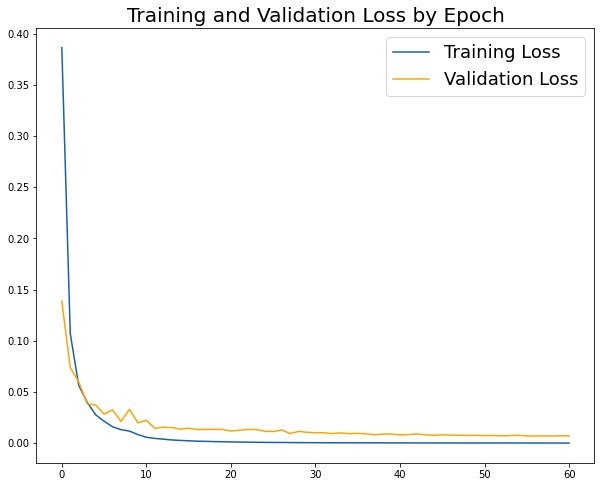

In [ ]:
plt.figure(figsize=(10, 8))
# Generate line plot of training, testing loss over epochs.
plt.plot(hist_1.history['loss'], label='Training Loss', color='#185fad')
plt.plot(hist_1.history['val_loss'], label='Validation Loss', color='orange')
# Set title
plt.title('Training and Validation Loss by Epoch', fontsize = 20)
plt.legend(fontsize = 18);

3/3 [==============================] - 0s 5ms/step - loss: 0.0065 - auc_1: 1.0000
Test evaluation [0.006496514193713665, 1.0]


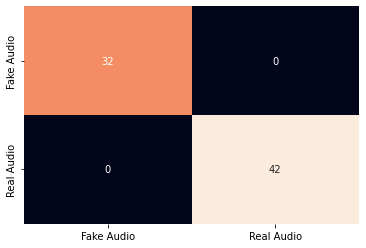

In [ ]:
print("Test evaluation", model_1.evaluate(X_test_data, y_test))
cm= confusion_matrix(y_test, y_pred=tf.round(model_1.predict(X_test_data)))
ax =sns.heatmap(cm, annot=True, cbar=False)

# Ticker labels -list must be in alphabetical order
ax.xaxis.set_ticklabels(["Fake Audio", "Real Audio"])
ax.yaxis.set_ticklabels(["Fake Audio", "Real Audio"])

plt.show();

### 2) Real audio data VS. Cloned audio data with removing the noise.

In [ ]:
from scipy.io import wavfile
import noisereduce as nr

In [ ]:
for file in os.listdir('/content/drive/MyDrive/Apziva /synthesizer_long_audio_version'):
  # load data
  rate, data = wavfile.read(f'/content/drive/MyDrive/Apziva /synthesizer_long_audio_version/{file}')
  # perform noise reduction
  reduced_noise = nr.reduce_noise(y=data, sr=rate)
  wavfile.write(f"/content/drive/MyDrive/Apziva /synthesizer_long_audio_version_without_noise{file}", rate, reduced_noise)

In [ ]:
#list the files
fake_file_list_without_noise = os.listdir('/content/drive/MyDrive/Apziva /synthesizer_long_audio_version_without_noise') 
#read them into pandas
fake_df_without_noise = pd.DataFrame(fake_file_list_without_noise)
# Renaming the column name to file
fake_df_without_noise = fake_df_without_noise.rename(columns={0:'file'})
fake_df_without_noise['real'] = 0
fake_df_without_noise.file = [f"/content/drive/MyDrive/Apziva /synthesizer_long_audio_version_without_noise/{i}" for i in fake_df_without_noise.file]
fake_df_without_noise.head(2)

,file,real
0,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
1,/content/drive/MyDrive/Apziva /synthesizer_lon...,0


In [ ]:
df_without_noise = pd.concat([real_df, fake_df_without_noise], axis=0)
df_without_noise = df_without_noise.sample(frac=1).reset_index(drop=True)
df_without_noise.head(2)

,file,real
0,/content/drive/MyDrive/Apziva /synthesizer_lon...,0
1,/content/drive/MyDrive/Apziva /real_audio/samp...,1


In [ ]:
X = df_without_noise[['file']]
y = df_without_noise.real
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42, shuffle=True)

In [ ]:
print(f"X_train length is: {len(X_train)}, y_train length is: {len(y_train)}")
print(f"X_test length is: {len(X_test)}, y_test length is: {len(y_test)}")
print(f"X_val length is: {len(X_val)}, y_val length is: {len(y_val)}")

X_train length is: 595, y_train length is: 595
X_test length is: 74, y_test length is: 74
X_val length is: 67, y_val length is: 67


In [ ]:
val_features = extract_features(X_val.file)
train_features = extract_features(X_train.file)
test_features = extract_features(X_test.file)

In [ ]:
X_val_data = concat_features(val_features)
X_train_data = concat_features(train_features)
X_test_data = concat_features(test_features)

In [ ]:
from IPython.display import Audio

tf.random.set_seed(42)

model_2 =tf.keras.Sequential([
                              tf.keras.layers.Dense(units=193, input_shape=(193,),activation="relu"),
                              tf.keras.layers.Dense(units=50, activation="relu"),
                              tf.keras.layers.Dense(units=1, activation="sigmoid")
])


model_2.compile(loss="binary_crossentropy",
                metrics=tf.keras.metrics.AUC(),
                optimizer=tf.keras.optimizers.Adam(learning_rate=0.000001))


early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2, verbose=1)

In [ ]:
hist_3 = model_2.fit(X_train_data, y_train, validation_data=(X_val_data, y_val), epochs=200, callbacks=[early_stop])

Epoch 1/200
19/19 [==============================] - 1s 19ms/step - loss: 0.6946 - auc_5: 0.8820 - val_loss: 0.7089 - val_auc_5: 0.8652
Epoch 2/200
19/19 [==============================] - 0s 5ms/step - loss: 0.6911 - auc_5: 0.8833 - val_loss: 0.7051 - val_auc_5: 0.8675
Epoch 3/200
19/19 [==============================] - 0s 5ms/step - loss: 0.6874 - auc_5: 0.8852 - val_loss: 0.7015 - val_auc_5: 0.8675
Epoch 4/200
19/19 [==============================] - 0s 6ms/step - loss: 0.6839 - auc_5: 0.8867 - val_loss: 0.6977 - val_auc_5: 0.8684
Epoch 5/200
19/19 [==============================] - 0s 6ms/step - loss: 0.6803 - auc_5: 0.8883 - val_loss: 0.6940 - val_auc_5: 0.8698
Epoch 6/200
19/19 [==============================] - 0s 5ms/step - loss: 0.6767 - auc_5: 0.8897 - val_loss: 0.6904 - val_auc_5: 0.8711
Epoch 7/200
19/19 [==============================] - 0s 6ms/step - loss: 0.6732 - auc_5: 0.8909 - val_loss: 0.6869 - val_auc_5: 0.8739
Epoch 8/200
19/19 [==============================] - 0

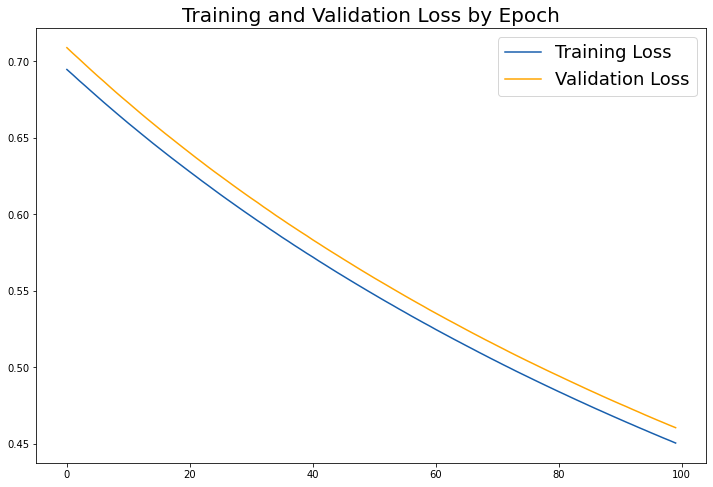

In [ ]:
plt.figure(figsize=(12, 8))
# Generate line plot of training, testing loss over epochs.
plt.plot(hist_3.history['loss'], label='Training Loss', color='#185fad')
plt.plot(hist_3.history['val_loss'], label='Validation Loss', color='orange')
# Set title
plt.title('Training and Validation Loss by Epoch', fontsize = 20)
plt.legend(fontsize = 18);

3/3 [==============================] - 0s 4ms/step - loss: 0.4548 - auc_4: 0.9481
test evaluation [0.45484626293182373, 0.9480993747711182]


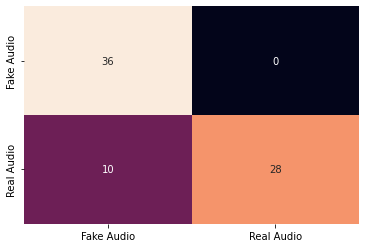

In [ ]:
print('test evaluation', model_2.evaluate(X_test_data, y_test))
cm = confusion_matrix(y_test, y_pred=tf.round(model_2.predict(X_test_data)))
ax = sns.heatmap(cm, annot=True, cbar=False)

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['Fake Audio', 'Real Audio'])
ax.yaxis.set_ticklabels(['Fake Audio', 'Real Audio'])

## Display the visualization of the Confusion Matrix.
plt.show()

In [ ]:
predictions_ = X_test.reset_index(drop=True)
predictions_['y_true'] = y_test
pred = np.round(model_2.predict(X_test_data)).reshape(74,)
predictions_['y_pred'] = pred
predictions_[predictions_.y_true != predictions_.y_pred]

,file,y_true,y_pred
0,/content/drive/MyDrive/Apziva /real_audio/samp...,NaN,1.0
1,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0
2,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0
3,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0
4,/content/drive/MyDrive/Apziva /real_audio/samp...,NaN,1.0
...,...,...,...
68,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0
69,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0
70,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0
71,/content/drive/MyDrive/Apziva /synthesizer_lon...,NaN,0.0


In [ ]:
Audio(predictions_.file[2], autoplay=True)

In [ ]:
Audio(predictions_.file[16], autoplay=True)

In [ ]:
Audio(predictions_.file[18], autoplay=True)

In [ ]:
Audio(predictions_.file[22], autoplay=True)

In [ ]:

Audio(predictions_.file[29], autoplay=True)

In [ ]:
Audio(predictions_.file[31], autoplay=True)